In [67]:
from pymongo import MongoClient
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer

In [68]:
# IMPORT DATA
client = MongoClient("mongodb://localhost:27017/")
collection = client["data"]["tf_idf"]

# DECLARE DATA
data = collection.find()
data = [[d['comment'], d['date']] for d in data]
printer = [print(d) for d in data]

['kasiann rakyat kwsn ikn hewan huni hutan huni biota sungai sungguh egois maruk serakah', '2022-01-01']
['tim kontra pro moga allah baik masyarakat situ moga proyek lancar dampak parah masyarakat moga ganti rugi padan perintah tolong perhati warga jangan bangun ibukota bangun rumah ekonomi warga dampak', '2022-01-01']
['bijak positif negatif cepat lambat pindah ibukota jakarta tidak tampung laju tumbuh duduk pusat bisnis perintah jadi tinggal masalah pindah pilih kaltim pikir rasional infrastruktur kaltim perintah tidak anggar bangun infrastruktur masyarakat heterogen mudah baur masyarakat datang', '2022-01-01']
['iya bos jangan ragu ambisi pindah monggo', '2022-01-01']
['alhamdulillah moga rakyat makmur sejahtera bangun ikn rakyat balikpapan', '2022-01-01']
['bangun gunung nggak banjir bangun rata banjir contoh tempat kaltim', '2022-01-01']
['maju ikn', '2022-01-01']
['kalimantan jantung dunia lebat pohon moga hutan tidak ganggu hormat kalimantan', '2022-01-01']
['tolak pindahj ibuko

In [69]:
# GROUP BY DATE
period = [[], [], [], [], [], [], [], [], [], [], [], []]

for d in data:
    if d[1] >= "2022-01-01" and d[1] <= "2022-01-31":
        period[0].append(d[0])
    elif d[1] >= "2022-02-01" and d[1] <= "2022-02-31":
        period[1].append(d[0])
    elif d[1] >= "2022-03-01" and d[1] <= "2022-03-31":
        period[2].append(d[0])
    elif d[1] >= "2022-04-01" and d[1] <= "2022-04-31":
        period[3].append(d[0])
    elif d[1] >= "2022-05-01" and d[1] <= "2022-05-31":
        period[4].append(d[0])
    elif d[1] >= "2022-06-01" and d[1] <= "2022-06-31":
        period[5].append(d[0])
    elif d[1] >= "2022-07-01" and d[1] <= "2022-07-31":
        period[6].append(d[0])
    elif d[1] >= "2022-08-01" and d[1] <= "2022-08-31":
        period[7].append(d[0])
    elif d[1] >= "2022-09-01" and d[1] <= "2022-09-31":
        period[8].append(d[0])
    elif d[1] >= "2022-10-01" and d[1] <= "2022-10-31":
        period[9].append(d[0])
    elif d[1] >= "2022-11-01" and d[1] <= "2022-11-31":
        period[10].append(d[0])
    elif d[1] >= "2022-12-01" and d[1] <= "2022-12-31":
        period[11].append(d[0])


printer = [print("Jumlah Komentar Bulan ke-"+str(i+1)+" = " + str(len(p))) for i,p in enumerate(period)]

Jumlah Komentar Bulan ke-1 = 10403
Jumlah Komentar Bulan ke-2 = 3154
Jumlah Komentar Bulan ke-3 = 2492
Jumlah Komentar Bulan ke-4 = 811
Jumlah Komentar Bulan ke-5 = 408
Jumlah Komentar Bulan ke-6 = 806
Jumlah Komentar Bulan ke-7 = 743
Jumlah Komentar Bulan ke-8 = 1291
Jumlah Komentar Bulan ke-9 = 463
Jumlah Komentar Bulan ke-10 = 560
Jumlah Komentar Bulan ke-11 = 352
Jumlah Komentar Bulan ke-12 = 323


In [70]:
# TF-IDF

df = [[], [], [], [], [], [], [], [], [], [], [], []]
for i, p in enumerate(period):
    vectorizer = TfidfVectorizer()
    tfidf_matrix = vectorizer.fit_transform(p)
    feature_names = vectorizer.get_feature_names_out()
    df[i] = pd.DataFrame(tfidf_matrix.toarray(), columns=feature_names)

term_frequencies = [[], [], [], [], [], [], [], [], [], [], [], []]
for i, d in enumerate(df):
    term_frequencies[i] = d.sum().to_dict()

printer = [print(tf) for tf in term_frequencies]

{'aa': 0.4218073058365192, 'aaaa': 0.3005964975260533, 'aaaamiiin': 0.496926667791107, 'aaah': 0.19393282133417927, 'aaahhh': 0.5392493190982579, 'aaaja': 0.3957762898002175, 'aah': 0.4587838958154583, 'aalam': 0.4994256062621777, 'aamiiin': 0.6523966023273897, 'aamiin': 15.078134744730574, 'aamiinn': 0.5454540384063179, 'aamiinnn': 0.8683519621885613, 'aamin': 0.8055112025990693, 'aamiun': 0.44324710918887866, 'aapi': 0.381648398697394, 'abad': 0.7269245832265744, 'abadi': 0.6200739832641491, 'abah': 1.4740806245962979, 'abai': 3.92892964047949, 'abaikn': 0.42071710178704974, 'abal': 3.618361916494233, 'abang': 0.490055373734375, 'abar': 0.4761307567295928, 'abbn': 0.37207174267277937, 'abda': 0.3685891111052016, 'abdal': 0.7447368305559949, 'abdi': 0.3492806493457554, 'abdul': 0.5371333545739463, 'abis': 6.139585694949205, 'abraham': 0.2571678770029231, 'abrek': 0.23678980339279682, 'abrik': 0.19754103293674913, 'absolut': 0.3347619330749307, 'absurd': 1.1707024267797164, 'abu': 2.82

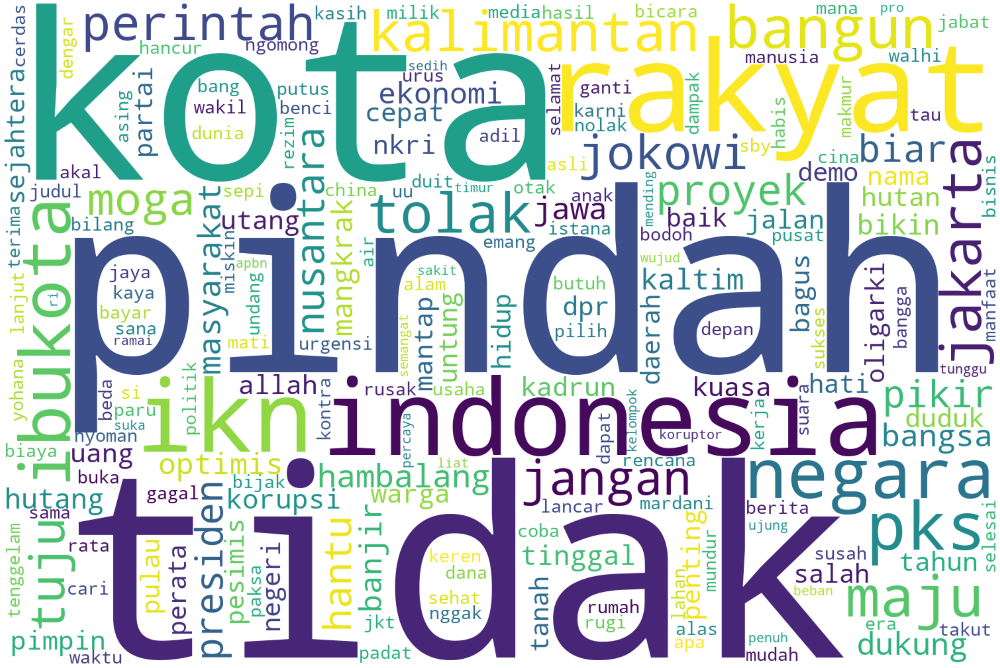

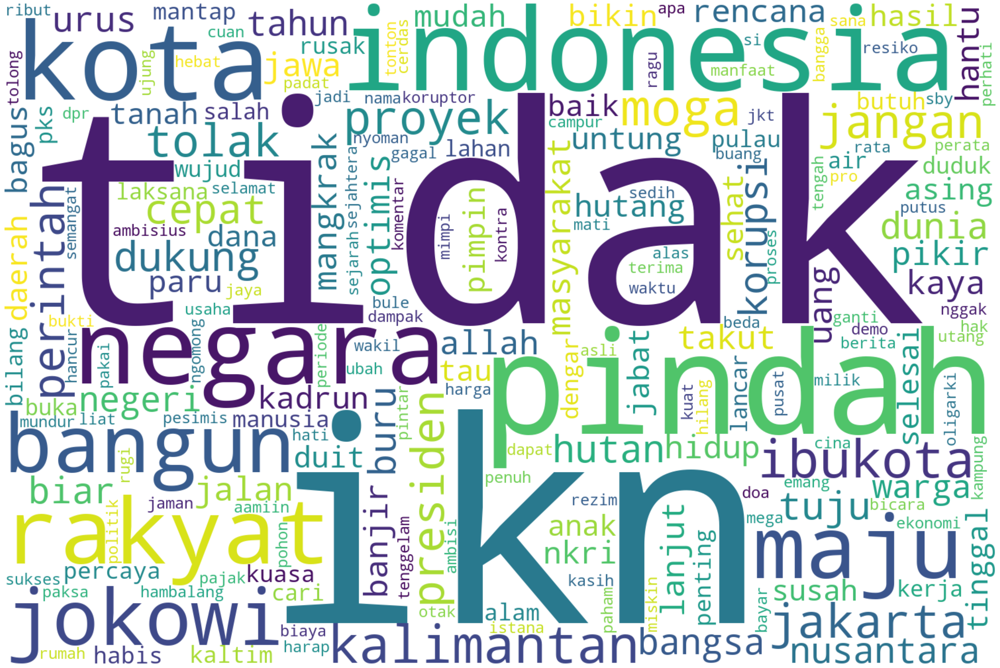

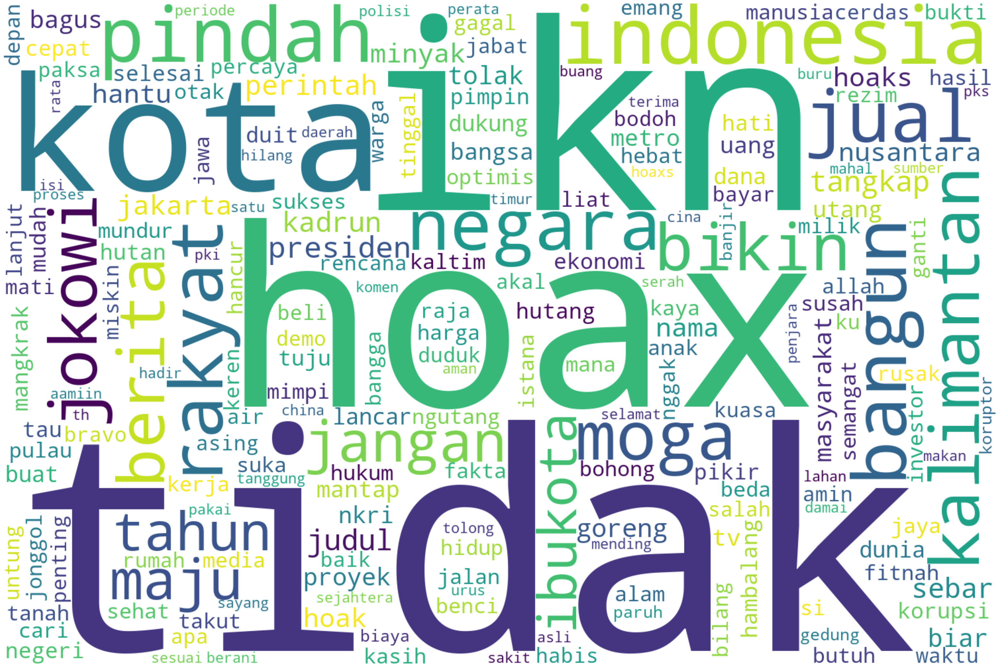

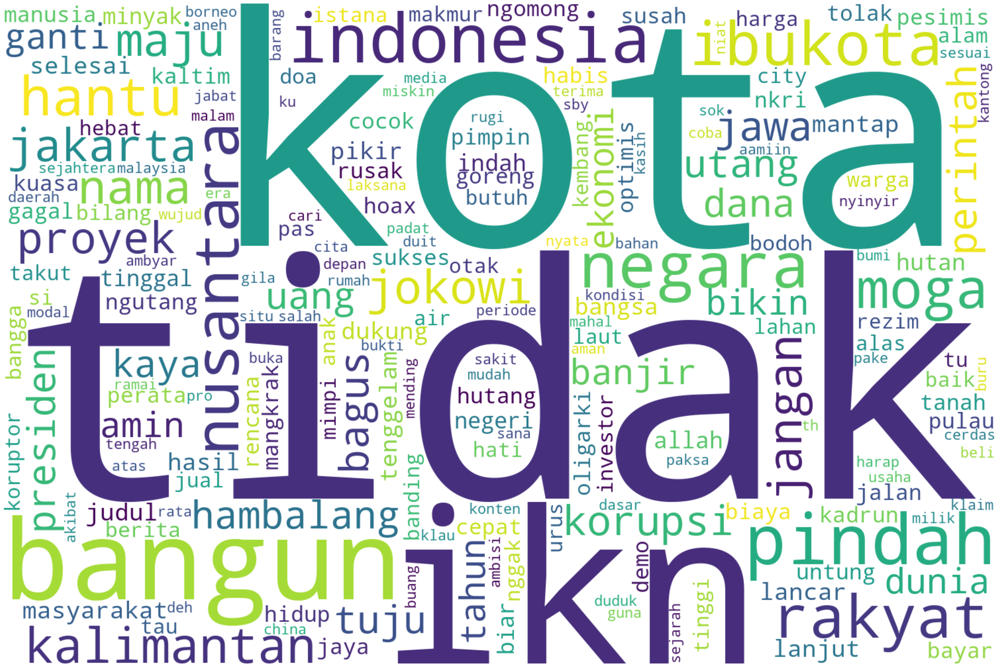

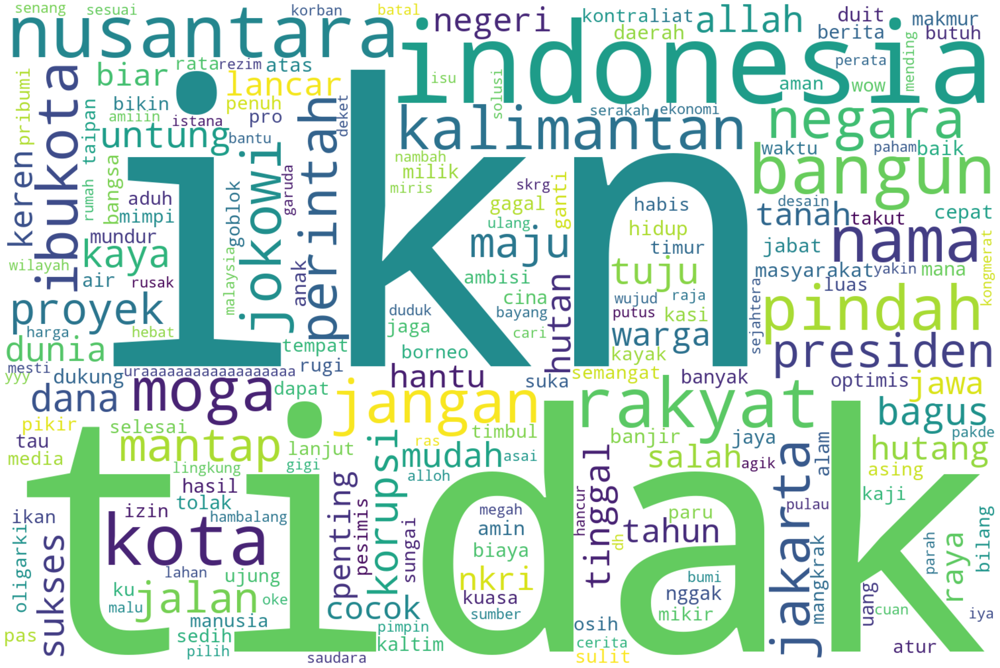

...

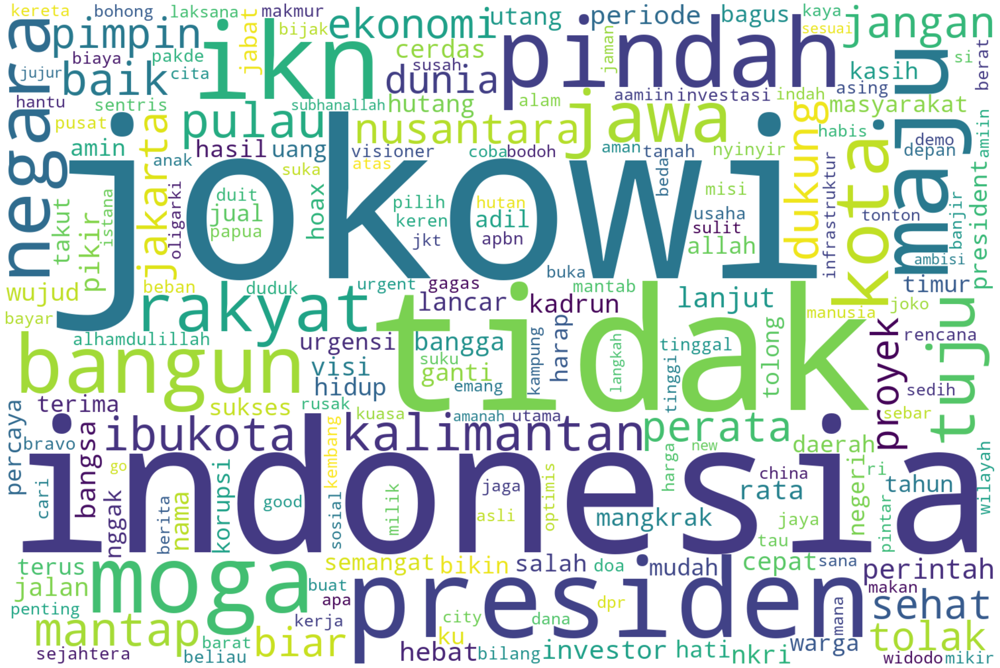

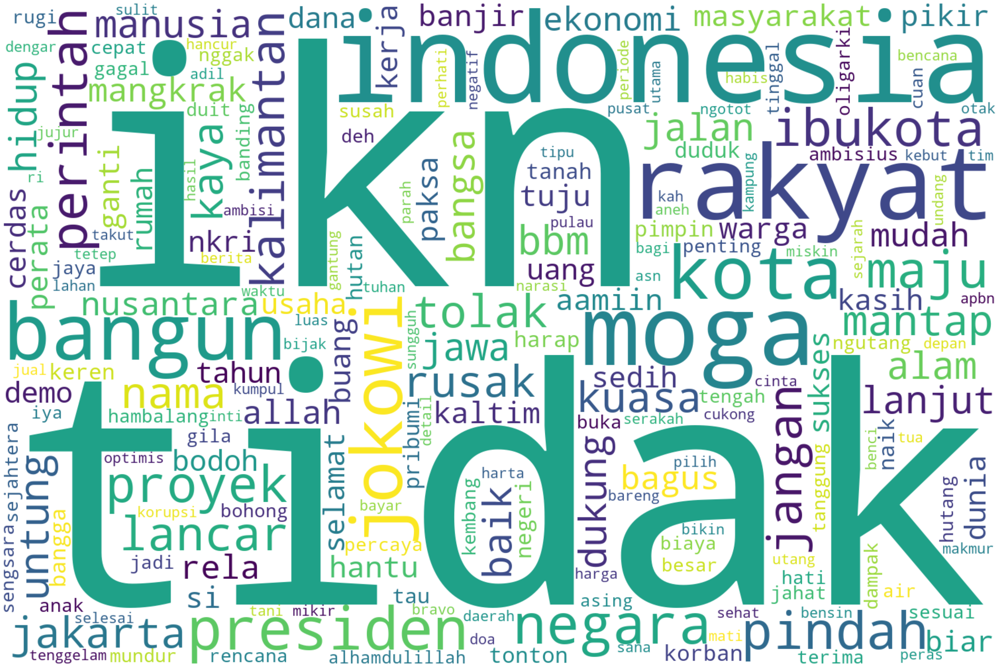

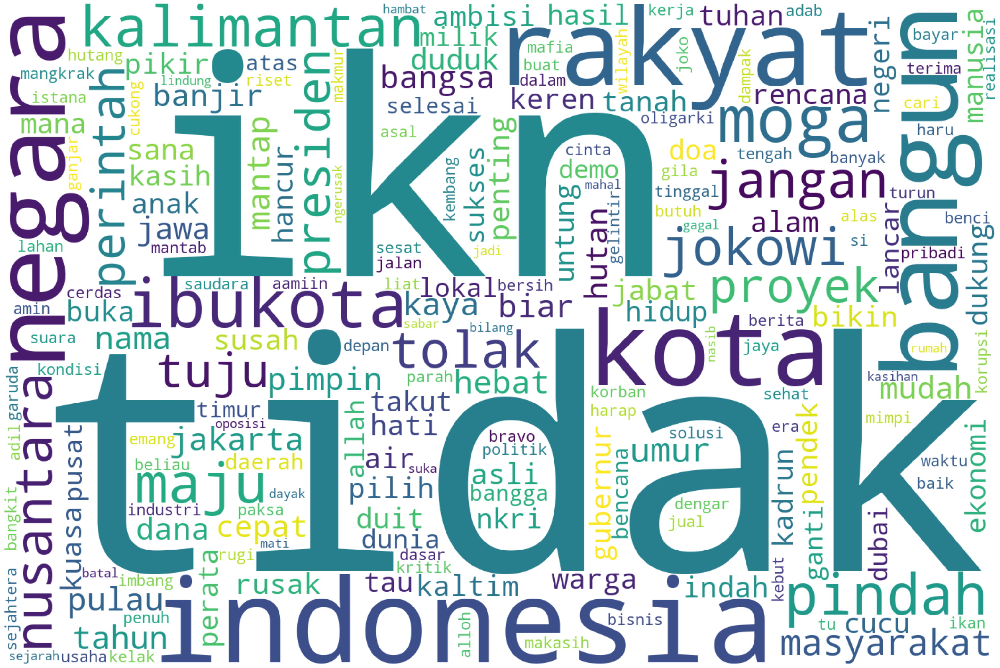

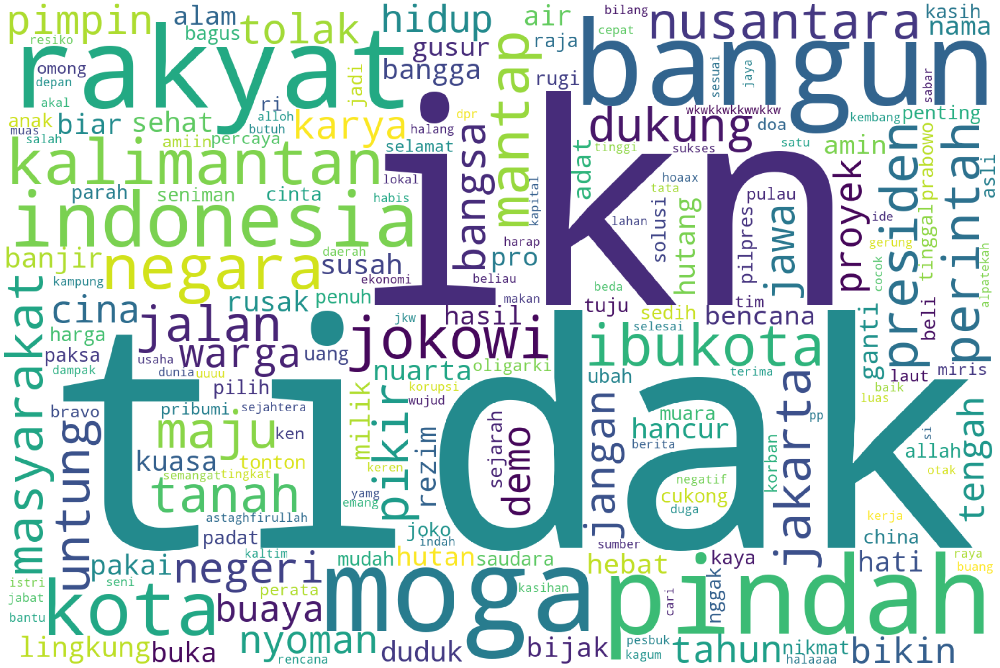

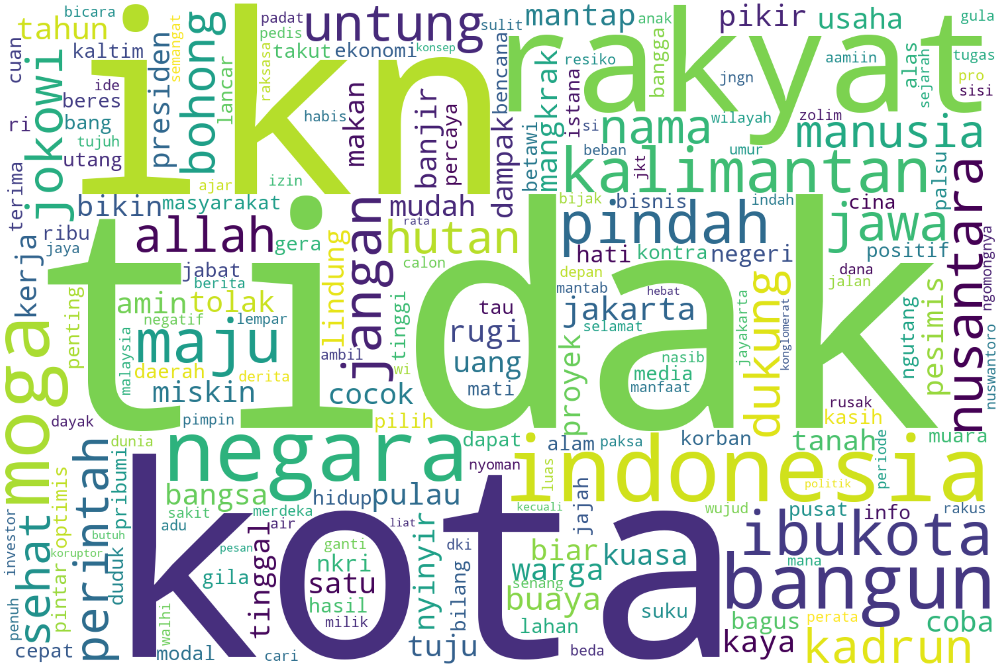

In [72]:
# Plot word cloud

wordcloud = [[], [], [], [], [], [], [], [], [], [], [], []]

for i, tf in enumerate(term_frequencies):
    wordcloud[i] = WordCloud(width=1500, height=1000, background_color='white').generate_from_frequencies(tf)
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud[i], interpolation='bilinear')
    plt.axis("off")
    plt.show()